<a href="https://colab.research.google.com/github/atul27-git/Airlines-Customer-satisfaction/blob/master/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
Data = pd.read_csv('Data.csv',na_values = '?')
Data.head()

,Customer ID,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3.0,4.0,3.0,1.0,5.0,3.0,5.0,5.0,4.0,3.0,4.0,4.0,5.0,5.0,25,18.0,0
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3.0,2.0,3.0,3.0,1.0,3.0,1.0,1.0,1.0,5.0,3.0,1.0,4.0,1.0,1,6.0,0
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2.0,2.0,2.0,2.0,5.0,5.0,5.0,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0,0.0,1
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2.0,5.0,5.0,5.0,2.0,2.0,2.0,2.0,2.0,5.0,3.0,1.0,4.0,2.0,11,9.0,0
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3.0,3.0,3.0,3.0,4.0,5.0,5.0,3.0,3.0,4.0,4.0,3.0,3.0,3.0,0,0.0,1


In [ ]:
Data.shape

(129880, 24)

In [ ]:
Data.drop('Customer ID', axis=1, inplace=True)

**EDA**

In [ ]:
!pip install pandas-profiling==2.8.0

     |████████████████████████████████| 266kB 4.0MB/s 
     |████████████████████████████████| 3.1MB 12.5MB/s 
     |████████████████████████████████| 604kB 36.5MB/s 
     |████████████████████████████████| 71kB 6.4MB/s 
     |████████████████████████████████| 61kB 5.6MB/s 
     |████████████████████████████████| 71kB 4.9MB/s 
     |████████████████████████████████| 296kB 42.4MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=c3c9d25e3d6e55113c870a0e59be205ce26b42e02c1176444dbec5f6e0f36f57
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for imagehash: filename=ImageHash-4.1.0-py2.py3-none-any.whl size=291991 sha256=f0c5fd61be07c069175f12759ea7e2836f086ad6cadb218cc29b05c0492d226a
  Stored in directory: /root/.cache/pip/wheels/07/1c/dc/6831446f09feb8cc199ec73a0f2f0703253f6ae013a22f4be9
Successfully built htmlmin imagehash
  Found existing installation: tqdm 4.41.1
    Un

In [ ]:
from pandas_profiling import ProfileReport
prof = ProfileReport(Data,title = 'Profile Report')
prof

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


**Label Encoding**

In [ ]:
cat_attribs = ['Gender','Customer Type','Type of Travel','Class']

In [ ]:
from sklearn.preprocessing import LabelEncoder
LE_obj = []
for attrib in cat_attribs:
  Obj = LabelEncoder()
  Data[attrib] = Obj.fit_transform(Data[attrib])
  LE_obj.append(Obj)
Data.head(10)

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,1,0,13,1,2,460,3.0,4.0,3.0,1.0,5.0,3.0,5.0,5.0,4.0,3.0,4.0,4.0,5.0,5.0,25,18.0,0
1,1,1,25,0,0,235,3.0,2.0,3.0,3.0,1.0,3.0,1.0,1.0,1.0,5.0,3.0,1.0,4.0,1.0,1,6.0,0
2,0,0,26,0,0,1142,2.0,2.0,2.0,2.0,5.0,5.0,5.0,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0,0.0,1
3,0,0,25,0,0,562,2.0,5.0,5.0,5.0,2.0,2.0,2.0,2.0,2.0,5.0,3.0,1.0,4.0,2.0,11,9.0,0
4,1,0,61,0,0,214,3.0,3.0,3.0,3.0,4.0,5.0,5.0,3.0,3.0,4.0,4.0,3.0,3.0,3.0,0,0.0,1
5,0,0,26,1,1,1180,3.0,4.0,2.0,1.0,1.0,2.0,1.0,1.0,3.0,4.0,4.0,4.0,4.0,1.0,0,0.0,0
6,1,0,47,1,1,1276,NaN,4.0,2.0,3.0,2.0,2.0,2.0,2.0,3.0,3.0,4.0,3.0,5.0,2.0,9,23.0,0
7,0,0,52,0,0,2035,4.0,3.0,4.0,4.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,4.0,5.0,4.0,4,0.0,1
8,0,0,41,0,0,853,1.0,2.0,2.0,2.0,4.0,3.0,3.0,1.0,1.0,2.0,1.0,4.0,1.0,2.0,0,0.0,0
9,1,1,20,0,1,1061,3.0,3.0,3.0,4.0,2.0,3.0,3.0,2.0,2.0,3.0,4.0,4.0,3.0,2.0,0,0.0,0


Stratified Shuffle Split

In [ ]:
from sklearn.model_selection import StratifiedShuffleSplit

split = StratifiedShuffleSplit(n_splits=5, test_size=0.1, random_state=42)
for train_index, test_index in split.split(Data, Data['satisfaction']):
  strat_train_set = Data.loc[train_index]
  strat_test_set = Data.loc[test_index]
strat_test_set.head(5)

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
85011,0,0,64,0,0,597,5.0,5.0,5.0,5.0,2.0,5.0,4.0,5.0,5.0,5.0,5.0,4.0,5.0,4.0,0,0.0,1
86199,0,0,35,1,1,1076,5.0,4.0,5.0,4.0,5.0,5.0,5.0,5.0,4.0,5.0,4.0,3.0,4.0,5.0,0,0.0,1
72336,0,0,43,0,1,591,2.0,4.0,2.0,4.0,1.0,4.0,3.0,2.0,2.0,2.0,2.0,1.0,2.0,3.0,0,0.0,0
70051,1,0,34,0,0,787,4.0,4.0,4.0,4.0,3.0,5.0,5.0,4.0,4.0,4.0,4.0,5.0,4.0,3.0,1,0.0,1
52015,1,0,31,0,0,2572,2.0,2.0,2.0,2.0,3.0,3.0,2.0,3.0,2.0,2.0,4.0,4.0,4.0,3.0,19,33.0,0


In [ ]:
strat_test_set["satisfaction"].value_counts() / len(strat_test_set)

0    0.565522
1    0.434478
Name: satisfaction, dtype: float64

In [ ]:
strat_train_set["satisfaction"].value_counts() / len(strat_train_set)

0    0.565539
1    0.434461
Name: satisfaction, dtype: float64

In [ ]:
Data = strat_train_set.copy()
Data.shape

(116892, 23)

In [ ]:
corr_matrix = Data.corr()
corr_matrix["satisfaction"].sort_values(ascending=False)

satisfaction                         1.000000
Online boarding                      0.501437
Inflight entertainment               0.398038
Seat comfort                         0.348813
On-board service                     0.322883
Leg room service                     0.313317
Cleanliness                          0.306648
Flight Distance                      0.297962
Inflight wifi service                0.282119
Baggage handling                     0.247255
Inflight service                     0.244870
Checkin service                      0.238676
Food and drink                       0.210525
Ease of Online booking               0.167827
Age                                  0.133439
Gender                               0.011927
Gate location                       -0.004979
Departure Delay in Minutes          -0.051544
Departure/Arrival time convenient   -0.056064
Arrival Delay in Minutes            -0.059852
Customer Type                       -0.185358
Class                             

Handling Outliers

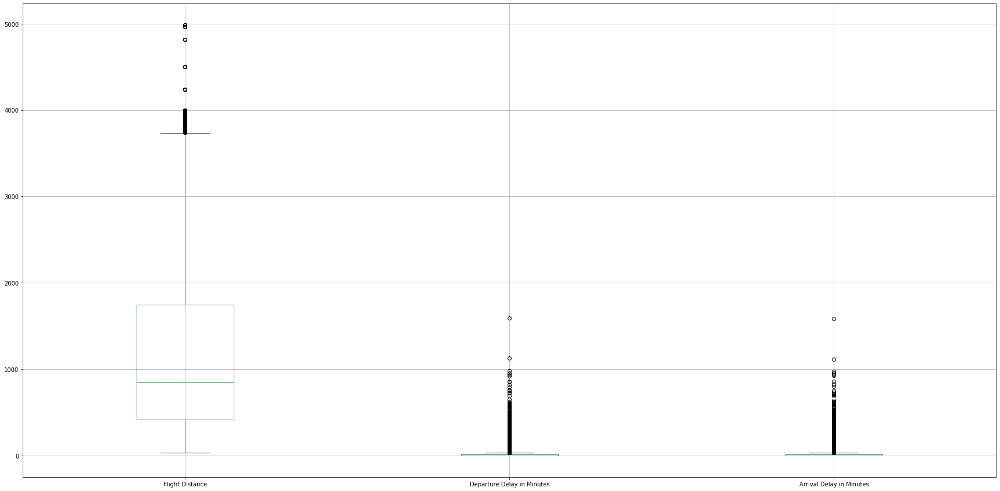

In [ ]:
Data[["Flight Distance", "Departure Delay in Minutes", "Arrival Delay in Minutes"]].boxplot(figsize=(30,15))

In [ ]:
att = ["Flight Distance", "Departure Delay in Minutes", "Arrival Delay in Minutes"]
Q1 = Data[att].quantile(0.00)
Q3 = Data[att].quantile(0.93)
IQR = Q3 - Q1

In [ ]:
train_data1 = Data[~((Data[['Flight Distance']] < (Q1 )) |(Data[['Flight Distance']] > (Q3 ))).any(axis=1)]
train_data2 = Data[((Data[['Flight Distance']] < (Q1 )) |(Data[['Flight Distance']] > (Q3 ))).any(axis=1)]

In [ ]:
print(train_data1.shape,train_data2.shape)

(108718, 23) (8174, 23)


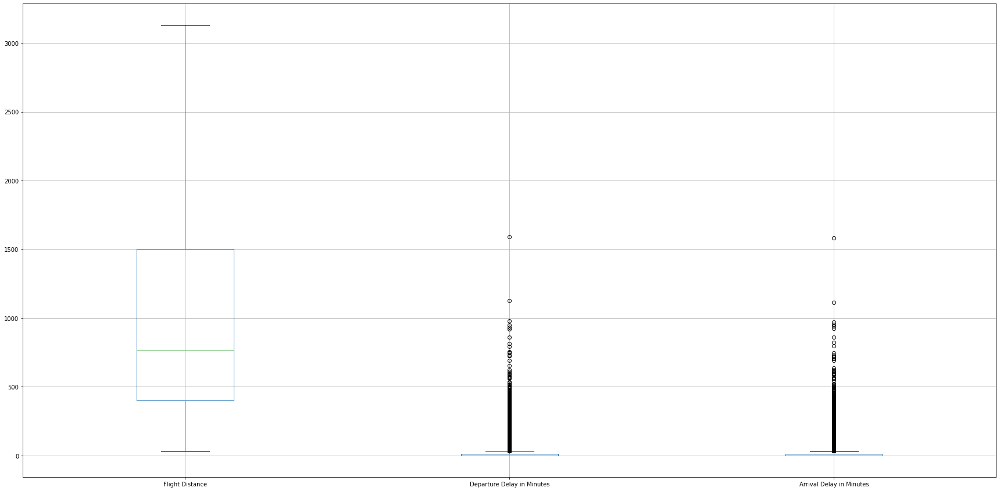

In [ ]:
train_data1[["Flight Distance", "Departure Delay in Minutes", "Arrival Delay in Minutes"]].boxplot(figsize=(30,15))

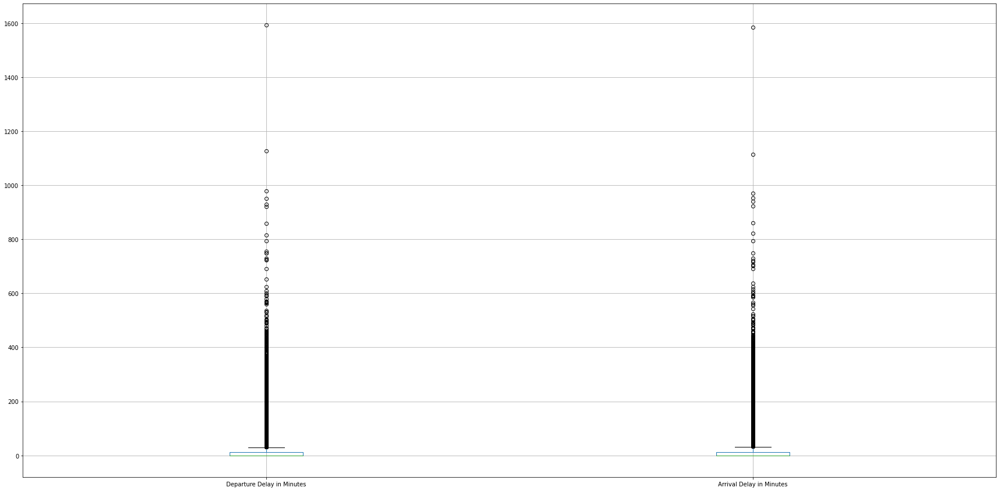

In [ ]:
AD = [ "Departure Delay in Minutes", "Arrival Delay in Minutes"]
train_data1[AD].boxplot(figsize=(30,15))

In [ ]:
n1 = train_data1[AD].quantile(0.99999)
t1 = train_data1[~(train_data1[AD] > (n1)).any(axis=1)]

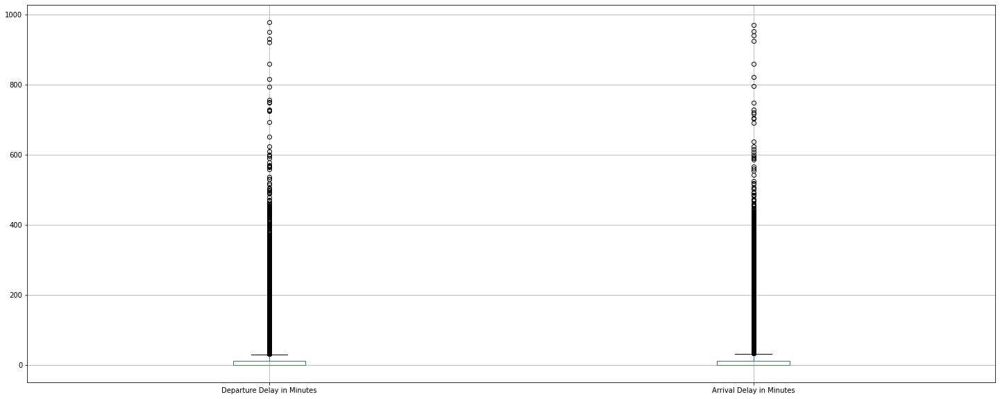

In [ ]:
t1[["Departure Delay in Minutes", "Arrival Delay in Minutes"]].boxplot(figsize=(25 ,10))

In [ ]:
t1.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
4575,0,1,36,0,0,404,2.0,2.0,2.0,2.0,1.0,2.0,1.0,1.0,4.0,3.0,5.0,4.0,4.0,1.0,6,15.0,0
47567,1,1,38,0,1,387,2.0,0.0,2.0,4.0,5.0,2.0,5.0,5.0,3.0,5.0,2.0,3.0,5.0,5.0,0,0.0,0
2893,0,0,44,0,0,2565,1.0,1.0,1.0,1.0,3.0,3.0,3.0,4.0,4.0,5.0,5.0,3.0,4.0,3.0,203,200.0,1
54797,0,0,29,0,0,1713,1.0,1.0,1.0,1.0,5.0,5.0,5.0,5.0,2.0,5.0,5.0,5.0,5.0,5.0,4,8.0,1
34893,0,1,26,0,1,239,2.0,3.0,3.0,3.0,5.0,3.0,5.0,5.0,2.0,3.0,4.0,4.0,3.0,5.0,0,0.0,0


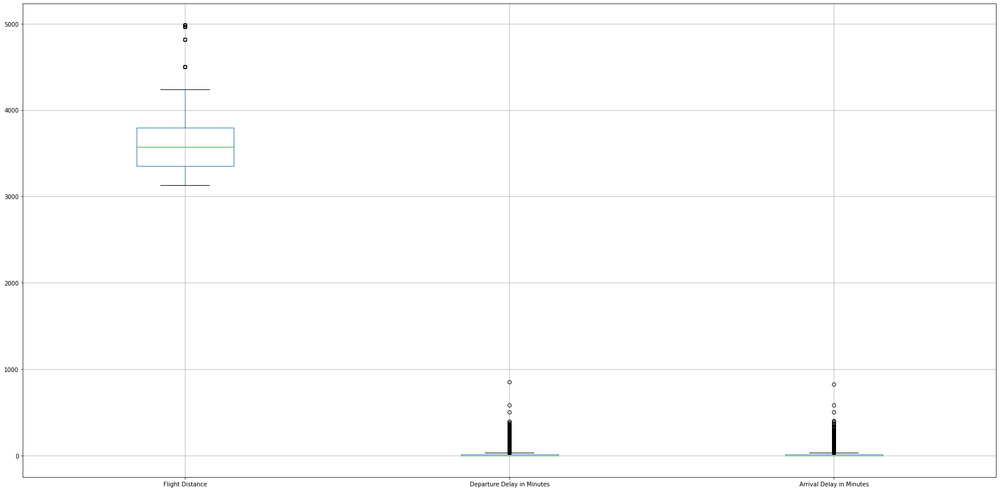

In [ ]:
train_data2[["Flight Distance","Departure Delay in Minutes","Arrival Delay in Minutes"]].boxplot(figsize=(30,15))

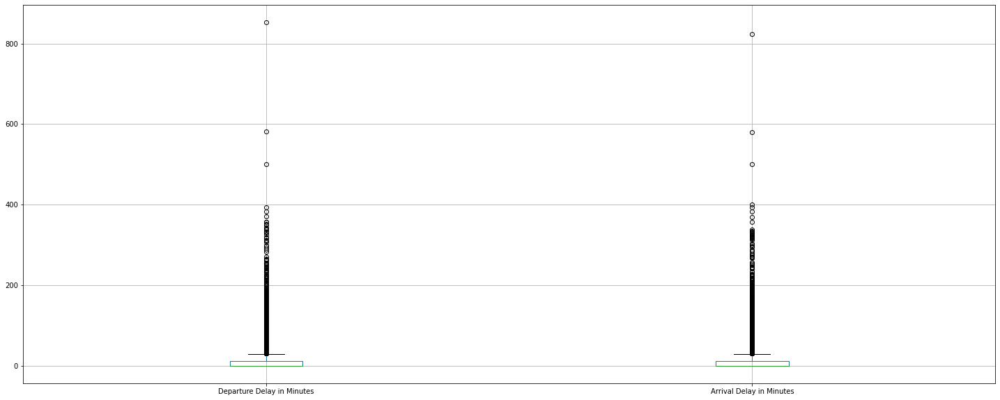

In [ ]:
train_data2[["Departure Delay in Minutes", "Arrival Delay in Minutes"]].boxplot(figsize=(25 ,10))

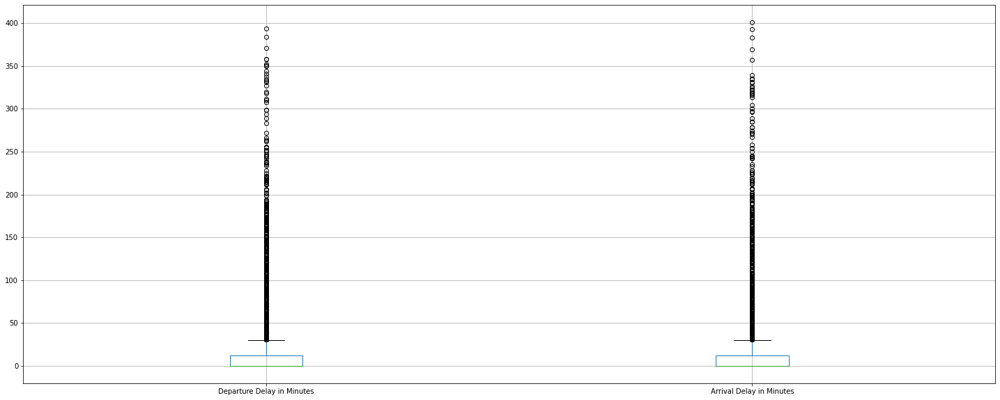

In [ ]:
n2 = train_data2.quantile(0.9997)
t2 = train_data2[~(train_data2[AD] > (n2)).any(axis=1)]
t2[["Departure Delay in Minutes", "Arrival Delay in Minutes"]].boxplot(figsize=(25 ,10))

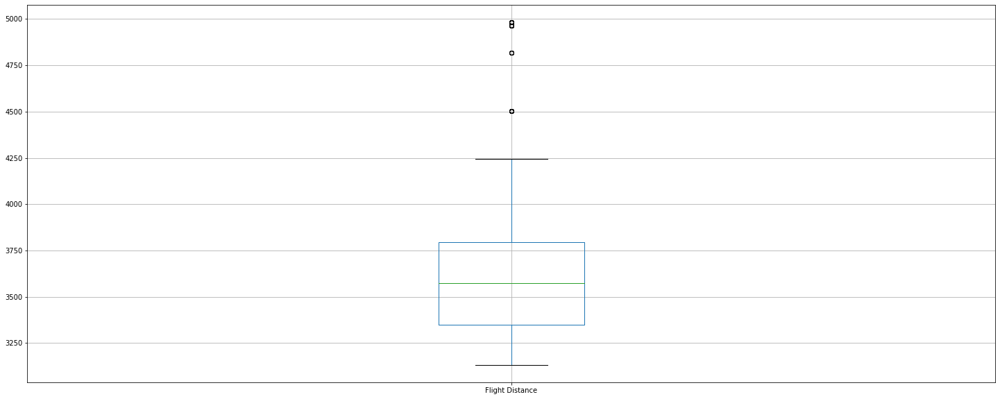

In [ ]:
t2[["Flight Distance"]].boxplot(figsize=(25 ,10))

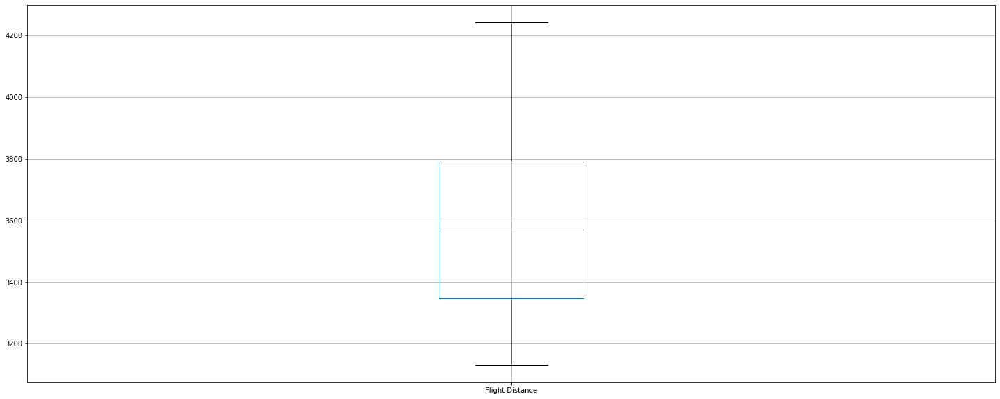

In [ ]:
t2 = t2[~(t2[["Flight Distance"]] > (4250)).any(axis=1)]

t2[['Flight Distance']].boxplot(figsize=(25 ,10))

In [ ]:
print(train_data1.shape,train_data2.shape)
print(t1.shape,t2.shape)

(108718, 23) (8174, 23)
(108716, 23) (8123, 23)


Handling Missing Data by droping row and replacing with Mode

In [ ]:
t1.isna().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  4
Departure/Arrival time convenient      3
Ease of Online booking                 3
Gate location                          7
Food and drink                         4
Online boarding                        3
Seat comfort                           1
Inflight entertainment                 4
On-board service                       3
Leg room service                       1
Baggage handling                       2
Checkin service                        3
Inflight service                       1
Cleanliness                            2
Departure Delay in Minutes             0
Arrival Delay in Minutes             339
satisfaction                           0
dtype: int64

In [ ]:
t1 = t1.dropna(subset = ['Gate location',  'Inflight wifi service', 'Food and drink', 'Departure/Arrival time convenient' , 'On-board service' ,'Leg room service' , 'Seat comfort' , 'Baggage handling'  ,'Checkin service', 'Inflight service'] )

In [ ]:
t1.isna().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 3
Gate location                          0
Food and drink                         0
Online boarding                        2
Seat comfort                           0
Inflight entertainment                 3
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            2
Departure Delay in Minutes             0
Arrival Delay in Minutes             339
satisfaction                           0
dtype: int64

In [ ]:
t1.shape

(108690, 23)

In [ ]:
t1= t1.fillna(t1[['Ease of Online booking' , 'Online boarding', 'Inflight entertainment' , 'Cleanliness' ]].mode().iloc[0])
t1.isna().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             339
satisfaction                           0
dtype: int64

In [ ]:
t2.isna().sum()

Gender                                0
Customer Type                         0
Age                                   0
Type of Travel                        0
Class                                 0
Flight Distance                       0
Inflight wifi service                 0
Departure/Arrival time convenient     0
Ease of Online booking                0
Gate location                         1
Food and drink                        0
Online boarding                       1
Seat comfort                          0
Inflight entertainment                0
On-board service                      0
Leg room service                      1
Baggage handling                      0
Checkin service                       0
Inflight service                      0
Cleanliness                           0
Departure Delay in Minutes            0
Arrival Delay in Minutes             19
satisfaction                          0
dtype: int64

In [ ]:
t2.dropna(subset = ['Gate location', 'Online boarding', 'Leg room service'] , inplace=True)

In [ ]:
t2.isna().sum()

Gender                                0
Customer Type                         0
Age                                   0
Type of Travel                        0
Class                                 0
Flight Distance                       0
Inflight wifi service                 0
Departure/Arrival time convenient     0
Ease of Online booking                0
Gate location                         0
Food and drink                        0
Online boarding                       0
Seat comfort                          0
Inflight entertainment                0
On-board service                      0
Leg room service                      0
Baggage handling                      0
Checkin service                       0
Inflight service                      0
Cleanliness                           0
Departure Delay in Minutes            0
Arrival Delay in Minutes             19
satisfaction                          0
dtype: int64

In [ ]:
t2.shape

(8121, 23)

Getting an optimum value of K for KNN by cross Validation on Logistic Regression.

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.pipeline import Pipeline

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.impute import KNNImputer

In [ ]:
# evaluate each strategy on the dataset
X, y = t1.iloc[:, :-1], t1.iloc[:, -1]

strategies = [str(i) for i in [1,3,5,7,9,15,18,21]]
for s in strategies:
	# modeling pipeline
	pipeline = Pipeline(steps=[('i', KNNImputer(n_neighbors=int(s))), ('m', LogisticRegression())])
	# evaluation
	cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=1)
	scores = cross_val_score(pipeline, X, y, scoring='accuracy', cv=cv, n_jobs=-1)
	print('>%s %.3f (%.3f)' % (s, np.mean(scores), np.std(scores)))

>1 0.829 (0.009)
>3 0.829 (0.010)
>5 0.826 (0.010)
>7 0.824 (0.009)
>9 0.827 (0.009)
>15 0.828 (0.008)
>18 0.823 (0.011)
>21 0.829 (0.009)


In [ ]:
X2 ,y2= t2.iloc[: , :-1] , t2.iloc[: , -1]
for s in strategies:
	# create the modeling pipeline
	pipeline = Pipeline(steps=[('i', KNNImputer(n_neighbors=int(s))), ('m', LogisticRegression())])
	# evaluate the model
	cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=1)
	scores = cross_val_score(pipeline, X2, y2, scoring='accuracy', cv=cv, n_jobs=-1)
	print('>%s %.3f (%.3f)' % (s, np.mean(scores), np.std(scores)))

>1 0.894 (0.007)
>3 0.894 (0.006)
>5 0.894 (0.006)
>7 0.894 (0.007)
>9 0.893 (0.007)
>15 0.895 (0.008)
>18 0.893 (0.008)
>21 0.893 (0.007)


Using the optimum K Value for KNN model for Imputation of missing Data. <br>
**KNN Imputation**

In [ ]:
imputer = KNNImputer(n_neighbors=1)

t3 = imputer.fit_transform(t1)
t3 = pd.DataFrame(t3 , columns= Data.columns)

t3

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0.0,1.0,36.0,0.0,0.0,404.0,2.0,2.0,2.0,2.0,1.0,2.0,1.0,1.0,4.0,3.0,5.0,4.0,4.0,1.0,6.0,15.0,0.0
1,1.0,1.0,38.0,0.0,1.0,387.0,2.0,0.0,2.0,4.0,5.0,2.0,5.0,5.0,3.0,5.0,2.0,3.0,5.0,5.0,0.0,0.0,0.0
2,0.0,0.0,44.0,0.0,0.0,2565.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,4.0,4.0,5.0,5.0,3.0,4.0,3.0,203.0,200.0,1.0
3,0.0,0.0,29.0,0.0,0.0,1713.0,1.0,1.0,1.0,1.0,5.0,5.0,5.0,5.0,2.0,5.0,5.0,5.0,5.0,5.0,4.0,8.0,1.0
4,0.0,1.0,26.0,0.0,1.0,239.0,2.0,3.0,3.0,3.0,5.0,3.0,5.0,5.0,2.0,3.0,4.0,4.0,3.0,5.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108685,1.0,0.0,69.0,1.0,1.0,1407.0,3.0,4.0,3.0,4.0,5.0,3.0,5.0,5.0,4.0,3.0,5.0,2.0,2.0,5.0,49.0,22.0,0.0
108686,0.0,0.0,42.0,0.0,0.0,543.0,1.0,1.0,3.0,1.0,4.0,5.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,5.0,73.0,60.0,1.0
108687,1.0,0.0,55.0,0.0,0.0,2938.0,5.0,5.0,1.0,5.0,3.0,4.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,4.0,0.0,0.0,1.0
108688,0.0,0.0,8.0,1.0,1.0,140.0,4.0,0.0,4.0,1.0,1.0,4.0,1.0,1.0,5.0,3.0,5.0,5.0,5.0,1.0,0.0,6.0,0.0


In [ ]:
t4 = imputer.fit_transform(t2)

t4 = pd.DataFrame(t4,columns = Data.columns)

t4

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0.0,0.0,26.0,0.0,0.0,3404.0,1.0,2.0,2.0,2.0,1.0,1.0,1.0,1.0,3.0,3.0,4.0,2.0,4.0,1.0,0.0,0.0,0.0
1,1.0,0.0,50.0,0.0,0.0,3976.0,3.0,3.0,3.0,3.0,5.0,5.0,5.0,2.0,2.0,2.0,2.0,5.0,2.0,4.0,0.0,0.0,1.0
2,0.0,0.0,23.0,0.0,0.0,3614.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,2.0,1.0,5.0,3.0,1.0,5.0,0.0,0.0,1.0
3,0.0,0.0,47.0,0.0,0.0,3360.0,4.0,4.0,4.0,4.0,3.0,4.0,5.0,5.0,5.0,5.0,5.0,4.0,5.0,4.0,0.0,0.0,1.0
4,1.0,0.0,45.0,0.0,0.0,3198.0,3.0,3.0,3.0,3.0,3.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,0.0,13.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8116,1.0,0.0,51.0,0.0,0.0,3422.0,3.0,1.0,1.0,1.0,4.0,2.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,1.0,28.0,26.0,0.0
8117,1.0,0.0,44.0,0.0,0.0,3848.0,2.0,2.0,2.0,2.0,2.0,4.0,5.0,4.0,4.0,4.0,4.0,3.0,4.0,3.0,74.0,65.0,1.0
8118,1.0,0.0,30.0,0.0,0.0,3575.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,1.0,4.0,3.0,3.0,4.0,2.0,26.0,25.0,0.0
8119,0.0,0.0,71.0,0.0,0.0,3404.0,3.0,3.0,2.0,3.0,5.0,4.0,4.0,4.0,4.0,4.0,4.0,5.0,4.0,4.0,0.0,0.0,1.0


In [ ]:
train_Data = pd.concat([t3, t4], ignore_index=True)

In [ ]:
train_Data

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0.0,1.0,36.0,0.0,0.0,404.0,2.0,2.0,2.0,2.0,1.0,2.0,1.0,1.0,4.0,3.0,5.0,4.0,4.0,1.0,6.0,15.0,0.0
1,1.0,1.0,38.0,0.0,1.0,387.0,2.0,0.0,2.0,4.0,5.0,2.0,5.0,5.0,3.0,5.0,2.0,3.0,5.0,5.0,0.0,0.0,0.0
2,0.0,0.0,44.0,0.0,0.0,2565.0,1.0,1.0,1.0,1.0,3.0,3.0,3.0,4.0,4.0,5.0,5.0,3.0,4.0,3.0,203.0,200.0,1.0
3,0.0,0.0,29.0,0.0,0.0,1713.0,1.0,1.0,1.0,1.0,5.0,5.0,5.0,5.0,2.0,5.0,5.0,5.0,5.0,5.0,4.0,8.0,1.0
4,0.0,1.0,26.0,0.0,1.0,239.0,2.0,3.0,3.0,3.0,5.0,3.0,5.0,5.0,2.0,3.0,4.0,4.0,3.0,5.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116806,1.0,0.0,51.0,0.0,0.0,3422.0,3.0,1.0,1.0,1.0,4.0,2.0,2.0,3.0,3.0,3.0,3.0,3.0,3.0,1.0,28.0,26.0,0.0
116807,1.0,0.0,44.0,0.0,0.0,3848.0,2.0,2.0,2.0,2.0,2.0,4.0,5.0,4.0,4.0,4.0,4.0,3.0,4.0,3.0,74.0,65.0,1.0
116808,1.0,0.0,30.0,0.0,0.0,3575.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,1.0,4.0,3.0,3.0,4.0,2.0,26.0,25.0,0.0
116809,0.0,0.0,71.0,0.0,0.0,3404.0,3.0,3.0,2.0,3.0,5.0,4.0,4.0,4.0,4.0,4.0,4.0,5.0,4.0,4.0,0.0,0.0,1.0


In [ ]:
X_train,Y_train = train_Data.iloc[:, :-1], train_Data.iloc[:, -1]
print(X_train.shape,Y_train.shape)

(116811, 22) (116811,)


**Preparing Test Data**

In [ ]:
Test_Data = strat_test_set.copy()
Test_Data

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
85011,0,0,64,0,0,597,5.0,5.0,5.0,5.0,2.0,5.0,4.0,5.0,5.0,5.0,5.0,4.0,5.0,4.0,0,0.0,1
86199,0,0,35,1,1,1076,5.0,4.0,5.0,4.0,5.0,5.0,5.0,5.0,4.0,5.0,4.0,3.0,4.0,5.0,0,0.0,1
72336,0,0,43,0,1,591,2.0,4.0,2.0,4.0,1.0,4.0,3.0,2.0,2.0,2.0,2.0,1.0,2.0,3.0,0,0.0,0
70051,1,0,34,0,0,787,4.0,4.0,4.0,4.0,3.0,5.0,5.0,4.0,4.0,4.0,4.0,5.0,4.0,3.0,1,0.0,1
52015,1,0,31,0,0,2572,2.0,2.0,2.0,2.0,3.0,3.0,2.0,3.0,2.0,2.0,4.0,4.0,4.0,3.0,19,33.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24472,0,0,32,0,0,2475,1.0,1.0,1.0,1.0,5.0,5.0,5.0,5.0,4.0,2.0,5.0,3.0,4.0,5.0,0,0.0,1
66360,1,0,28,1,1,916,4.0,1.0,4.0,2.0,4.0,4.0,4.0,4.0,1.0,4.0,3.0,4.0,2.0,4.0,0,0.0,0
70493,1,0,38,0,0,628,4.0,4.0,4.0,4.0,4.0,3.0,3.0,1.0,4.0,4.0,3.0,3.0,1.0,3.0,210,209.0,1
74920,0,0,47,0,0,2962,2.0,2.0,2.0,2.0,2.0,5.0,4.0,5.0,5.0,5.0,5.0,5.0,5.0,3.0,0,0.0,1


In [ ]:
Test_Data.shape

(12988, 23)

In [ ]:
Test_Data.isna().sum()

Gender                                0
Customer Type                         0
Age                                   0
Type of Travel                        0
Class                                 0
Flight Distance                       0
Inflight wifi service                 0
Departure/Arrival time convenient     1
Ease of Online booking                0
Gate location                         0
Food and drink                        1
Online boarding                       2
Seat comfort                          0
Inflight entertainment                0
On-board service                      0
Leg room service                      0
Baggage handling                      0
Checkin service                       0
Inflight service                      0
Cleanliness                           0
Departure Delay in Minutes            0
Arrival Delay in Minutes             35
satisfaction                          0
dtype: int64

In [ ]:
Test_Data.dropna(subset = ['Departure/Arrival time convenient', 'Food and drink', 'Online boarding','Arrival Delay in Minutes'] , inplace=True)

In [ ]:
sum(Test_Data.isna().sum())

0

In [ ]:
X_test,Y_test = Test_Data.iloc[:, :-1], Test_Data.iloc[:, -1]
print(X_test.shape,Y_test.shape)

(12951, 22) (12951,)


**Scaling of Data**

Standard Scaler

In [ ]:
from sklearn.preprocessing import StandardScaler
STDscaler = StandardScaler()

In [ ]:
X_train = STDscaler.fit_transform(X_train)
X_train

array([[-9.85947660e-01,  2.11060053e+00, -2.26876890e-01, ...,
        -1.73950296e+00, -2.32269002e-01, -2.74891039e-03],
       [ 1.01425262e+00,  2.11060053e+00, -9.45935203e-02, ...,
         1.30409797e+00, -3.93196994e-01, -3.99335536e-01],
       [-9.85947660e-01, -4.73798801e-01,  3.02256588e-01, ...,
        -2.17702500e-01,  5.05153341e+00,  4.88848614e+00],
       ...,
       [ 1.01425262e+00, -4.73798801e-01, -6.23726998e-01, ...,
        -9.78602732e-01,  3.04157639e-01,  2.61642173e-01],
       [-9.85947660e-01, -4.73798801e-01,  2.08808207e+00, ...,
         5.43197733e-01, -3.93196994e-01, -3.99335536e-01],
       [ 1.01425262e+00, -4.73798801e-01,  5.66823326e-01, ...,
        -2.17702500e-01, -3.66375662e-01, -3.46457319e-01]])

In [ ]:
X_test = STDscaler.transform(X_test)
X_test

array([[-0.98594766, -0.4737988 ,  1.62509028, ...,  0.54319773,
        -0.39319699, -0.39933554],
       [-0.98594766, -0.4737988 , -0.29301857, ...,  1.30409797,
        -0.39319699, -0.39933554],
       [-0.98594766, -0.4737988 ,  0.2361149 , ..., -0.2177025 ,
        -0.39319699, -0.39933554],
       ...,
       [ 1.01425262, -0.4737988 , -0.09459352, ..., -0.2177025 ,
         5.23928273,  5.12643812],
       [-0.98594766, -0.4737988 ,  0.50068164, ..., -0.2177025 ,
        -0.39319699, -0.39933554],
       [ 1.01425262, -0.4737988 , -1.68199395, ..., -1.73950296,
        -0.39319699, -0.39933554]])

Min Max Scaler

In [ ]:
from sklearn.preprocessing import MinMaxScaler
MMscaler = MinMaxScaler()

In [ ]:
X_train = MMscaler.fit_transform(X_train)
X_train

array([[0.        , 1.        , 0.37179487, ..., 0.2       , 0.00613497,
        0.01546392],
       [1.        , 1.        , 0.3974359 , ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.47435897, ..., 0.6       , 0.20756646,
        0.20618557],
       ...,
       [1.        , 0.        , 0.29487179, ..., 0.4       , 0.02658487,
        0.0257732 ],
       [0.        , 0.        , 0.82051282, ..., 0.8       , 0.        ,
        0.        ],
       [1.        , 0.        , 0.52564103, ..., 0.6       , 0.00102249,
        0.00206186]])

In [ ]:
X_test = MMscaler.transform(X_test)
X_test

array([[0.        , 0.        , 0.73076923, ..., 0.8       , 0.        ,
        0.        ],
       [0.        , 0.        , 0.35897436, ..., 1.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.46153846, ..., 0.6       , 0.        ,
        0.        ],
       ...,
       [1.        , 0.        , 0.3974359 , ..., 0.6       , 0.21472393,
        0.21546392],
       [0.        , 0.        , 0.51282051, ..., 0.6       , 0.        ,
        0.        ],
       [1.        , 0.        , 0.08974359, ..., 0.2       , 0.        ,
        0.        ]])

Converting Data back to DataFrame

In [ ]:
X_train = pd.DataFrame(X_train)
X_test = pd.DataFrame(X_test)
X_train

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
0,0.0,1.0,0.371795,0.0,0.0,0.088557,0.4,0.4,0.4,0.4,0.2,0.4,0.2,0.2,0.8,0.6,1.00,0.8,0.8,0.2,0.006135,0.015464
1,1.0,1.0,0.397436,0.0,0.5,0.084520,0.4,0.0,0.4,0.8,1.0,0.4,1.0,1.0,0.6,1.0,0.25,0.6,1.0,1.0,0.000000,0.000000
2,0.0,0.0,0.474359,0.0,0.0,0.601614,0.2,0.2,0.2,0.2,0.6,0.6,0.6,0.8,0.8,1.0,1.00,0.6,0.8,0.6,0.207566,0.206186
3,0.0,0.0,0.282051,0.0,0.0,0.399335,0.2,0.2,0.2,0.2,1.0,1.0,1.0,1.0,0.4,1.0,1.00,1.0,1.0,1.0,0.004090,0.008247
4,0.0,1.0,0.243590,0.0,0.5,0.049383,0.4,0.6,0.6,0.6,1.0,0.6,1.0,1.0,0.4,0.6,0.75,0.8,0.6,1.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116806,1.0,0.0,0.564103,0.0,0.0,0.805081,0.6,0.2,0.2,0.2,0.8,0.4,0.4,0.6,0.6,0.6,0.50,0.6,0.6,0.2,0.028630,0.026804
116807,1.0,0.0,0.474359,0.0,0.0,0.906220,0.4,0.4,0.4,0.4,0.4,0.8,1.0,0.8,0.8,0.8,0.75,0.6,0.8,0.6,0.075665,0.067010
116808,1.0,0.0,0.294872,0.0,0.0,0.841406,0.4,0.4,0.4,0.4,0.4,0.4,0.4,0.4,0.2,0.8,0.50,0.6,0.8,0.4,0.026585,0.025773
116809,0.0,0.0,0.820513,0.0,0.0,0.800807,0.6,0.6,0.4,0.6,1.0,0.8,0.8,0.8,0.8,0.8,0.75,1.0,0.8,0.8,0.000000,0.000000


Importing Libraries

In [ ]:
from sklearn import model_selection

from sklearn.ensemble import VotingClassifier

from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb

from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score

**Feature Reduction**

In [ ]:
for_features = RandomForestClassifier(n_estimators = 800, max_features = 'auto', max_depth = 5, min_samples_leaf = 2, min_samples_split = 100)

In [ ]:
for_features.fit(X_train, Y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=5, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=100,
                       min_weight_fraction_leaf=0.0, n_estimators=800,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
#using the columns of strat_train_set since the labels of 
Features_names = list(strat_train_set.columns)
Features = list(X_train.columns)
importance = for_features.feature_importances_

In [ ]:
import matplotlib.pyplot as plt

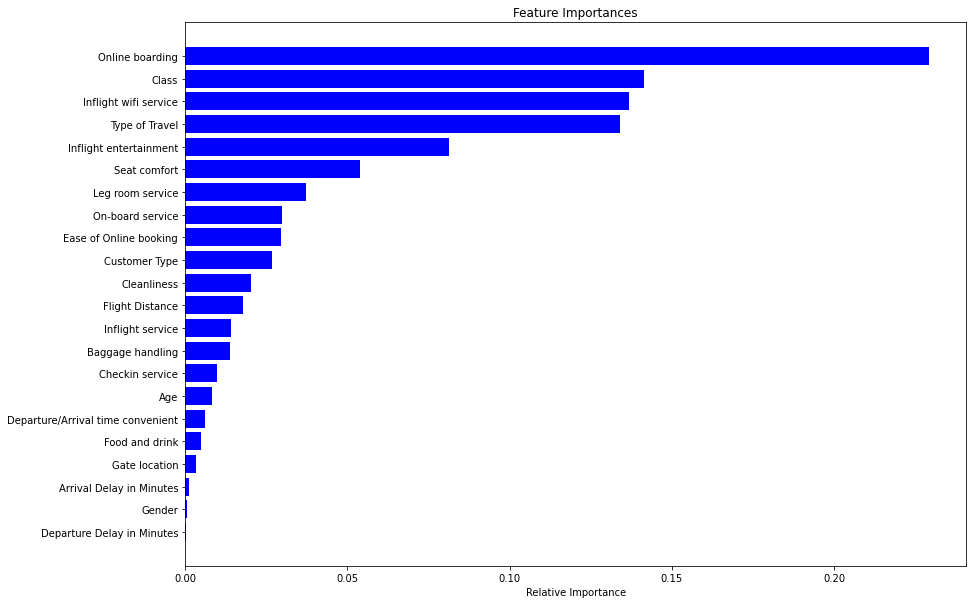

In [ ]:
indices = np.argsort(importance)

plt.figure(figsize=(14,10))
plt.barh(range(len(indices)), importance[indices], color='b', align='center')
plt.yticks(range(len(indices)), [Features_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.title('Feature Importances')
plt.show()

In [ ]:
print(Features)
print(Features_names)
print(importance)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21]
['Gender', 'Customer Type', 'Age', 'Type of Travel', 'Class', 'Flight Distance', 'Inflight wifi service', 'Departure/Arrival time convenient', 'Ease of Online booking', 'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort', 'Inflight entertainment', 'On-board service', 'Leg room service', 'Baggage handling', 'Checkin service', 'Inflight service', 'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes', 'satisfaction']
[0.0006715  0.02664532 0.00838229 0.13411446 0.14127617 0.01777118
 0.13679482 0.00610235 0.02947763 0.00334135 0.00482946 0.22927582
 0.05391991 0.08118918 0.02971081 0.03733954 0.01371986 0.009654
 0.01423813 0.02012669 0.00031087 0.00110863]


In [ ]:
selected_feat = [feat for imp,feat in zip(importance,Features) if imp >= 0.01]
selected_feat

[1, 3, 4, 5, 6, 8, 11, 12, 13, 14, 15, 16, 18, 19]

In [ ]:
len(selected_feat)

14

In [ ]:
X_train_2 = X_train[selected_feat]

In [ ]:
X_train_2

,1,3,4,5,6,8,11,12,13,14,15,16,18,19
0,1.0,0.0,0.0,0.088557,0.4,0.4,0.4,0.2,0.2,0.8,0.6,1.00,0.8,0.2
1,1.0,0.0,0.5,0.084520,0.4,0.4,0.4,1.0,1.0,0.6,1.0,0.25,1.0,1.0
2,0.0,0.0,0.0,0.601614,0.2,0.2,0.6,0.6,0.8,0.8,1.0,1.00,0.8,0.6
3,0.0,0.0,0.0,0.399335,0.2,0.2,1.0,1.0,1.0,0.4,1.0,1.00,1.0,1.0
4,1.0,0.0,0.5,0.049383,0.4,0.6,0.6,1.0,1.0,0.4,0.6,0.75,0.6,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116806,0.0,0.0,0.0,0.805081,0.6,0.2,0.4,0.4,0.6,0.6,0.6,0.50,0.6,0.2
116807,0.0,0.0,0.0,0.906220,0.4,0.4,0.8,1.0,0.8,0.8,0.8,0.75,0.8,0.6
116808,0.0,0.0,0.0,0.841406,0.4,0.4,0.4,0.4,0.4,0.2,0.8,0.50,0.8,0.4
116809,0.0,0.0,0.0,0.800807,0.6,0.4,0.8,0.8,0.8,0.8,0.8,0.75,0.8,0.8


In [ ]:
X_test_2 = X_test[selected_feat]

In [ ]:
X_test_2

,1,3,4,5,6,8,11,12,13,14,15,16,18,19
0,0.0,0.0,0.0,0.134378,1.0,1.0,1.0,0.8,1.0,1.0,1.0,1.00,1.0,0.8
1,0.0,1.0,0.5,0.248101,1.0,1.0,1.0,1.0,1.0,0.8,1.0,0.75,0.8,1.0
2,0.0,0.0,0.5,0.132953,0.4,0.4,0.8,0.6,0.4,0.4,0.4,0.25,0.4,0.6
3,0.0,0.0,0.0,0.179487,0.8,0.8,1.0,1.0,0.8,0.8,0.8,0.75,0.8,0.6
4,0.0,0.0,0.0,0.603276,0.4,0.4,0.6,0.4,0.6,0.4,0.4,0.75,0.8,0.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12946,0.0,0.0,0.0,0.580247,0.2,0.2,1.0,1.0,1.0,0.8,0.4,1.00,0.8,1.0
12947,0.0,1.0,0.5,0.210114,0.8,0.8,0.8,0.8,0.8,0.2,0.8,0.50,0.4,0.8
12948,0.0,0.0,0.0,0.141738,0.8,0.8,0.6,0.6,0.2,0.8,0.8,0.50,0.2,0.6
12949,0.0,0.0,0.0,0.695869,0.4,0.4,1.0,0.8,1.0,1.0,1.0,1.00,1.0,0.6


**Weighted VotingClassifier of *Random Forest - 0.8*, *KNN - 0.15* and *MNB - 0.5***.

In [ ]:
model1w = RandomForestClassifier(n_estimators = 800, max_features = 'auto', max_depth = 5, min_samples_leaf = 2, min_samples_split = 100)

In [ ]:
model2w = KNeighborsClassifier(p = 1, n_neighbors = 2,  leaf_size = 4, algorithm = 'brute', weights = 'distance')

In [ ]:
model3w = MultinomialNB()

In [ ]:
for_weighted = []
for_weighted.append(('Forest', model1w))
for_weighted.append(('KNN', model2w))
for_weighted.append(('MNB', model3w))

In [ ]:
print(for_weighted)

[('Forest', RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=5, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=100,
                       min_weight_fraction_leaf=0.0, n_estimators=800,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)), ('KNN', KNeighborsClassifier(algorithm='brute', leaf_size=4, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=2, p=1,
                     weights='distance')), ('MNB', MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True))]


In [ ]:
weighted_model = VotingClassifier(estimators = for_weighted, voting ='soft',weights = [0.8,0.15,0.05])
weighted_model.fit(X_train, Y_train)

VotingClassifier(estimators=[('Forest',
                              RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=5,
                                                     max_features='auto',
                                                     max_leaf_nodes=None,
                                                     max_samples=None,
                                                     min_impurity_decrease=0.0,
                                                     min_impurity_split=None,
                                                     min_samples_leaf=2,
                                                     min_samples_split=100,
                                                     min_weight_fraction_leaf=0.0,
     

In [ ]:
weighted_preds = weighted_model.predict(X_test)

In [ ]:
print(X_test.shape)

(12951, 22)


In [ ]:
accuracy_weighted = accuracy_score(Y_test, weighted_preds)
print('Accuracy:',accuracy_weighted)

f1_weights = f1_score(Y_test, weighted_preds, average='binary')
print('F-Measure:' ,f1_weights)

Accuracy: 0.9338275036676704
F-Measure: 0.9222675736961451


**For weighted with feature reduction**

In [ ]:
model_w1 = RandomForestClassifier(n_estimators = 800, max_features = 'auto', max_depth = 5, min_samples_leaf = 2, min_samples_split = 100)

In [ ]:
model_w2 = KNeighborsClassifier(p = 1, n_neighbors = 2,  leaf_size = 4, algorithm = 'brute', weights = 'distance')

In [ ]:
model_w3 = MultinomialNB()

In [ ]:
for_weighted2 = []
for_weighted2.append(('Forest', model_w1))
for_weighted2.append(('KNN', model_w2))
for_weighted2.append(('MNB', model_w3))

In [ ]:
print(for_weighted2)

[('Forest', RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=5, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=2, min_samples_split=100,
                       min_weight_fraction_leaf=0.0, n_estimators=800,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)), ('KNN', KNeighborsClassifier(algorithm='brute', leaf_size=4, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=2, p=1,
                     weights='distance')), ('MNB', MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True))]


In [ ]:
weighted_model2 = VotingClassifier(estimators = for_weighted2, voting ='soft',weights = [0.8,0.015,0.05])
weighted_model2.fit(X_train_2, Y_train)

VotingClassifier(estimators=[('Forest',
                              RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=5,
                                                     max_features='auto',
                                                     max_leaf_nodes=None,
                                                     max_samples=None,
                                                     min_impurity_decrease=0.0,
                                                     min_impurity_split=None,
                                                     min_samples_leaf=2,
                                                     min_samples_split=100,
                                                     min_weight_fraction_leaf=0.0,
     

In [ ]:
print(X_train_2.shape)
print(X_test_2.shape)

(116811, 14)
(12951, 14)


In [ ]:
weighted_preds2 = weighted_model2.predict(X_test_2)

In [ ]:
accuracy_weighted2 = accuracy_score(Y_test, weighted_preds2)
print('Accuracy:',accuracy_weighted2)

f1_weights2 = f1_score(Y_test, weighted_preds2, average='binary')
print('F-Measure:',f1_weights2)

Accuracy: 0.9298895838159216
F-Measure: 0.9184479971259206


**Final code ends**




**Unweighted ensemble model consisting of *RF,XGB,KNN and MNB*.**

In [ ]:
model1 = RandomForestClassifier(n_estimators = 800, max_features = 'auto', max_depth = 5, min_samples_leaf = 2, min_samples_split = 100)

In [ ]:
model2 = xgb.XGBClassifier(n_estimators = 1000, learning_rate = 0.001,  max_depth=6, min_child_weight=7,
                    gamma=0.6, subsample=0.8, colsample_bytree=0.7, reg_alpha = 100,
                      objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27)

In [ ]:
model3 = KNeighborsClassifier(p = 1, n_neighbors = 2,  leaf_size = 4, algorithm = 'brute', weights = 'distance')

In [ ]:
model4 = MultinomialNB()

In [ ]:
# Voting Ensemble for Classification
seed = 7
kfold = model_selection.KFold(n_splits = 10, random_state = seed, shuffle = True)

In [ ]:
# create the sub models
estimator = []

estimator.append(('Forest', model1))
estimator.append(('XGB', model2))
estimator.append(('KNN', model3))
estimator.append(('MNB', model4))

In [ ]:
# create the ensemble model
ensemble_model = VotingClassifier(estimators = estimator, voting ='soft')
ensemble_model.fit(X_train, Y_train)

VotingClassifier(estimators=[('Forest',
                              RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=5,
                                                     max_features='auto',
                                                     max_leaf_nodes=None,
                                                     max_samples=None,
                                                     min_impurity_decrease=0.0,
                                                     min_impurity_split=None,
                                                     min_samples_leaf=2,
                                                     min_samples_split=100,
                                                     min_weight_fraction_leaf=0.0,
     

**Evaluation on Random Samples of Training Data**

In [ ]:
x,y = X_train[46000:47000],Y_train[46000:47000]

In [ ]:
cv_scores = model_selection.cross_val_score(ensemble_model, x,y, cv=kfold)
print('>%s %.3f (%.3f)' % (s, np.mean(cv_scores), np.std(cv_scores)))

>9 0.735 (0.033)


In [ ]:
Y_train_preds = ensemble_model.predict(X_train[87000:97000])
Y_train_true = Y_train[87000:97000]

In [ ]:
Y_train_preds = pd.DataFrame(Y_train_preds)
Y_train_true = pd.DataFrame(Y_train_true)
print(type(Y_train_preds))
print(type(Y_train_true))

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


In [ ]:
score = f1_score(Y_train_true, Y_train_preds, average='binary')
print('F-Measure: %.3f' % score)

F-Measure: 0.954


CV + F1

In [ ]:
x_2,y_2 = X_train[100:12200],Y_train[100:12200]

In [ ]:
cv_scores = model_selection.cross_val_score(ensemble_model, x_2,y_2, cv=kfold, scoring='f1_macro')
print('>%s %.3f (%.3f)' % (s, np.mean(cv_scores), np.std(cv_scores)))

>21 0.906 (0.008)


**Evaluation on Test Data without feature reduction**

In [ ]:
ensemble1_predict = ensemble_model.predict(X_test)

NameError: ignored

Model Accuracy and f1 score without feature extraction

In [ ]:
ensemble1_accuracy = accuracy_score(Y_test, ensemble1_predict)
print('Model Accuracy %.3f'%ensemble1_accuracy)

ensemble1_f1 = f1_score(Y_test, ensemble1_predict, average='binary')
print('F-Measure: %.3f' %ensemble1_f1)

Model Accuracy 0.870


**Unweighted ensemble model of *RF,XGB,KNN and MNB* trained on feature Extracted Data**

In [ ]:
model11 = RandomForestClassifier(n_estimators = 800, max_features = 'auto', max_depth = 5, min_samples_leaf = 2, min_samples_split = 100)

In [ ]:
model22 = xgb.XGBClassifier(n_estimators = 1000, learning_rate = 0.001,  max_depth=6, min_child_weight=7,
                    gamma=0.6, subsample=0.8, colsample_bytree=0.7, reg_alpha = 100,
                      objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27)

In [ ]:
model33 = KNeighborsClassifier(p = 1, n_neighbors = 2,  leaf_size = 4, algorithm = 'brute', weights = 'distance')

In [ ]:
model44 = MultinomialNB()

In [ ]:
# create the sub models
estimator2 = []

estimator2.append(('Forest', model11))
estimator2.append(('XGB', model22))
estimator2.append(('KNN', model33))
estimator2.append(('MNB', model44))

In [ ]:
estimator2

[('Forest',
  RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                         criterion='gini', max_depth=5, max_features='auto',
                         max_leaf_nodes=None, max_samples=None,
                         min_impurity_decrease=0.0, min_impurity_split=None,
                         min_samples_leaf=2, min_samples_split=100,
                         min_weight_fraction_leaf=0.0, n_estimators=800,
                         n_jobs=None, oob_score=False, random_state=None,
                         verbose=0, warm_start=False)),
 ('XGB', XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
                colsample_bynode=1, colsample_bytree=0.7, gamma=0.6,
                learning_rate=0.001, max_delta_step=0, max_depth=6,
                min_child_weight=7, missing=None, n_estimators=1000, n_jobs=1,
                nthread=4, objective='binary:logistic', random_state=0,
                reg_alpha=100, reg_lambda=1, scale_pos_wei

In [ ]:
print(X_train_2.shape,Y_train.shape)

(116811, 14) (116811,)


In [ ]:
# create the ensemble model after feature extraction
ensemble_model2 = VotingClassifier(estimators = estimator2, voting ='soft')
ensemble_model2.fit(X_train_2, Y_train)

VotingClassifier(estimators=[('Forest',
                              RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=5,
                                                     max_features='auto',
                                                     max_leaf_nodes=None,
                                                     max_samples=None,
                                                     min_impurity_decrease=0.0,
                                                     min_impurity_split=None,
                                                     min_samples_leaf=2,
                                                     min_samples_split=100,
                                                     min_weight_fraction_leaf=0.0,
     

In [ ]:
print(X_test_2.shape,Y_test.shape)

(12951, 14) (12951,)


In [ ]:
ensemble2_predict = ensemble_model2.predict(X_test_2)

In [ ]:
ensemble2_accuracy = accuracy_score(Y_test, ensemble2_predict)
print('Accuracy: %.3f' %ensemble2_accuracy)

ensemble2_f1 = f1_score(Y_test, ensemble2_predict, average='binary')
print('F-Measure: %.3f' %ensemble2_f1)

0.8983090108871902

**Difference of accuracy and f1score of unweigted ensemble model before and after feature reduction.**

In [ ]:
print('Difference in accuracy:',(ensemble2_accuracy_2 - ensemble1_accuracy))
print('Difference in f1_scores:',(ensemble2_f1 - ensemble1_f1))

Difference in accuracy: 0.028337580109644045
Difference in f1_scores: 0.031957751512005084


**Individual Models**

**XGB Model**

In [ ]:
XGB_model = xgb.XGBClassifier(n_estimators = 1000, learning_rate = 0.001,  max_depth=6, min_child_weight=7,
                    gamma=0.6, subsample=0.8, colsample_bytree=0.7, reg_alpha = 100,
                      objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27)

In [ ]:
XGB_model.fit(X_train_2, Y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7, gamma=0.6,
              learning_rate=0.001, max_delta_step=0, max_depth=6,
              min_child_weight=7, missing=None, n_estimators=1000, n_jobs=1,
              nthread=4, objective='binary:logistic', random_state=0,
              reg_alpha=100, reg_lambda=1, scale_pos_weight=1, seed=27,
              silent=None, subsample=0.8, verbosity=1)

In [ ]:
XGB_predict = XGB_model.predict(X_test_2)

In [ ]:
XGB_accuracy = accuracy_score(Y_test, XGB_predict)
print('Accuracy: %.3f' %XGB_accuracy)

XGB_f1 = f1_score(Y_test, XGB_predict, average='binary')
print('F-Measure: %.3f' %XGB_f1)

0.9370704964867578

**Random Forest**(same model which was used for feature extraction)

In [ ]:
RF_predict = for_features.predict(X_test)

In [ ]:
RF_accuracy = accuracy_score(Y_test, RF_predict)
print('Accuracy: %.3f' %RF_accuracy)

RF_f1 = f1_score(Y_test, RF_predict, average='binary')
print('F-Measure: %.3f' %RF_f1)

Accuracy: 0.927
F-Measure: 0.914


**KNN**

In [ ]:
KNN_model = KNeighborsClassifier(p = 1, n_neighbors = 2,  leaf_size = 4, algorithm = 'brute', weights = 'distance')

In [ ]:
KNN_model.fit(X_train_2, Y_train)

KNeighborsClassifier(algorithm='brute', leaf_size=4, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=2, p=1,
                     weights='distance')

In [ ]:
KNN_predict = KNN_model.predict(X_test_2)

In [ ]:
KNN_accuracy = accuracy_score(Y_test, KNN_predict)
print('Accuracy: %.3f' %KNN_accuracy)

KNN_f1 = f1_score(Y_test, KNN_predict, average='binary')
print('F-Measure: %.3f' %KNN_f1)

Accuracy: 0.932
F-Measure: 0.921


**MNB**

In [ ]:
MNB_model = MultinomialNB()

In [ ]:
MNB_model.fit(X_train_2, Y_train)

MultinomialNB(alpha=1.0, class_prior=None, fit_prior=True)

In [ ]:
MNB_predict = MNB_model.predict(X_test_2)

In [ ]:
MNB_accuracy = accuracy_score(Y_test, MNB_predict)
print('Accuracy: %.3f' %MNB_accuracy)

MNB_f1 = f1_score(Y_test, MNB_predict, average='binary')
print('F-Measure: %.3f' %MNB_f1)

Accuracy: 0.810
F-Measure: 0.779


**Ensembler**



```
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold, KFold
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.metrics import f1_score
import pandas as pd
import os
import sys
import logging
```





```
def binarylogloss(actual, predicted, eps=1e-15):
    """Logarithmic Loss metric.
    :param actual: Array containing the actual target classes
    :param predicted: Matrix with class predictions, one probability per class
    """
    # Convert 'actual' to a binary array if it's not already:
    if len(actual.shape) == 1:
        actual2 = np.zeros((actual.shape[0], predicted.shape[1]))
        for i, val in enumerate(actual):
            actual2[i, val] = 1
        actual = actual2

    clip = np.clip(predicted, eps, 1 - eps)
    rows = actual.shape[0]
    vsota = np.sum(actual * np.log(clip))
    return -1.0 / rows * vsota
```





```
logging.basicConfig(
    level=logging.DEBUG,
    format="[%(asctime)s] %(levelname)s %(message)s",
    datefmt="%H:%M:%S",  stream=sys.stdout)
logger = logging.getLogger(__name__)

```





```
class Ensembler(object):
    def __init__(self,model_dict, 
                 num_folds=3, 
                 task_type='classification', 
                 optimize=roc_auc_score, 
                 lower_is_better=False,
                 save_path = None):
        
        """
        Ensembler init function
        : param model dict: model dictionary
        : param num_folds: the number of folds for ensembling
        : param task_type: classification or regression
        : param optimze: the function to optmize for eg: AUC, logloss, etc. Must have two arguments y_test and y_pred
        :param lower_is_better: is lower value better for optimizer fuction or higher
        :param save_path: path to which model pickles will be dumped to along with generated predictions, or None
        """
        
        self.model_dict = model_dict
        self.levels = len(self.model_dict)
        self.num_folds = num_folds
        self.task_type = task_type
        self.optimize = optimize
        self.lower_is_better = lower_is_better
        self.save_path = save_path
        
        self.training_data = None
        self.test_data = None
        self.y = None
        self.lbl_enc = None
        self.y_enc = None
        self.train_prediction_dict = None
        self.test_prediction_dict = None
        self.num_classes = None
        
    def fit(self, training_data, y, lentrain):
        """
            training_data: trainingdata in tabular form
            y: binary, multiclass or regression
            return: chain of models to be used in prediction                
        """
        self.training_data = training_data
        self.y = y

        if self.task_type == 'classification':
            self.num_classes = len(np.unique(self.y))
            #print(self.num_classes)
            logger.info("Found %d classed", self.num_classes)
            self.lbl_enc = LabelEncoder()
            self.y_enc = self.y
            kf = StratifiedKFold(n_splits = self.num_folds)
            train_prediction_shape = (lentrain, self.num_classes)
        else:
            self.num_classes = -1
            self.y_enc = self.y
            kf = KFold(n_splits = self.num_folds)
            train_prediction_shape = (lentrain, 1)
        
        self.train_prediction_dict = {}
        
        for level in range(self.levels):
            self.train_prediction_dict[level] = np.zeros((train_prediction_shape[0], 
                                                          train_prediction_shape[1]*len(self.model_dict[level])))
        print((self.train_prediction_dict[0].shape))
        for level in range(self.levels):
            if level == 0:
                temp_train = self.training_data
            else:
                temp_train = self.train_prediction_dict[level-1]
            
            for model_num, model in enumerate(self.model_dict[level]):
                validation_scores = []
                foldnum = 1
                # print(len(self.train_prediction_dict), self.y.shape)
                for train_idx, valid_idx in kf.split(self.train_prediction_dict[0], self.y):
                    logger.info("Training level %d Fold # %d. Model # %d", level, foldnum, model_num)
                    if level != 0:
                        l_training_data = temp_train[train_idx]
                        l_validation_data = temp_train[valid_idx]
                        logger.info(" length %d " , len(l_training_data))
                        model.fit(l_training_data, self.y_enc.iloc[train_idx])
                    else:
                        l0_training_data = temp_train[0][model_num]
                        
                        if type(l0_training_data) == list:
                            l_training_data = [x[train_idx] for x in l0_training_data]
                            l_validation_data = [x[valid_idx] for x in l0_training_data]
                        else:
                            l_training_data = l0_training_data.iloc[train_idx]
                            l_validation_data = l0_training_data.iloc[valid_idx]
                        
                        model.fit(l_training_data, self.y_enc.iloc[train_idx])
                        
                    logger.info("Predicting Level %d. Fold # %d. Model # %d", level, foldnum, model_num)
                    
                    if self.task_type == 'classification':
                        #print(len(l_validation_data))
                        temp_train_prediction = model.predict(l_validation_data)
                        #print(temp_train_prediction.shape)
                        #print(model_num)
                        self.train_prediction_dict[level][valid_idx, model_num] = temp_train_prediction #(model_num* self.num_classes):(model_num * self.num_classes) + self.num_classes
                    else:
                        temp_train_prediction = model.predict(l_validation_data)
                        self.train_prediction_dict[level][valid_idx, model_num] = temp_train_prediction
                    
                    # print(len(self.y_enc[valid_idx]), len(temp_train_prediction))
                    validation_score = self.optimize(self.y_enc.iloc[valid_idx], temp_train_prediction)
                    validation_scores.append(validation_score)
                    logger.info("Level %d. Fold # %d. Model # %d. Validation Score = %f", level, foldnum, model_num,validation_score)
                    
                    foldnum += 1
                
                
                avg_score = np.mean(validation_scores)
                std_score = np.std(validation_scores)
                
                logger.info("Level %d. Model # %d. Mean Score = %f. Std Dev = %f", level, model_num, avg_score, std_score)
                
                train_prediction_df = pd.DataFrame(self.train_prediction_dict[level])
                train_prediction_df.to_csv(os.path.join(self.save_path, 
                                                        "train_predictions_level_" + str(level) + ".csv"), index=False, header=None)
                #print(self.train_prediction_dict)
        
        return self.train_prediction_dict
        
    def predict(self, test_data, lentest):
        self.test_data = test_data
        if self.task_type == 'classification':
            test_prediction_shape = (lentest, self.num_classes)
        else:
            test_prediction_shape = (lentest, 1)
        
        self.test_prediction_dict = {}
        
        for level in range(self.levels):
            self.test_prediction_dict[level] = np.zeros((test_prediction_shape[0], 
                                                          test_prediction_shape[1]*len(self.model_dict[level])))
            self.test_data = test_data
            
        for level in range(self.levels):
            if level == 0:
                temp_train = self.training_data
                temp_test = self.test_data
            else:
                temp_train = self.train_prediction_dict[level-1]
                temp_test = self.test_prediction_dict[level-1]
                
            for model_num, model in enumerate(self.model_dict[level]):
                
                logger.info("Training Fulldata Level %d. Model # %d", level, model_num)
                
                # if level == 0:
                #     model.fit(temp_train[0][model_num], self.y_enc)
                # else:
                #     model.fit(temp_train, self.y_enc)
                
                logger.info("Predicting Test Level %d. Model # %d", level, model_num)
                
                if self.task_type == 'classification':
                    if level == 0:
                        test_tmp_prediction = model.predict_proba(temp_test[0][model_num])
                        g=np.argmax(test_tmp_prediction ,axis=-1)
                        g=np.take_along_axis(test_tmp_prediction, np.expand_dims(g, axis=-1), axis=-1)
                    else:
                        test_tmp_prediction = model.predict_proba(temp_test)
                        g=np.argmax(test_tmp_prediction ,axis=-1)
                        g=np.take_along_axis(test_tmp_prediction, np.expand_dims(g, axis=-1), axis=-1)
                    
                    # print(g[0])
                    # print(type(g))
                    print(test_tmp_prediction)
                    self.test_prediction_dict[level][:, model_num :model_num+2] = test_tmp_prediction
            
            test_prediction_df = pd.DataFrame(self.test_prediction_dict[level])
            test_prediction_df.to_csv(os.path.join(self.save_path, "test_predictions_level_" + str(level)+ ".csv"), index = False, header=None)
            
        return self.test_prediction_dict
```





```
rf=RandomForestClassifier(n_estimators = 800, max_features = 'auto', max_depth = 5, min_samples_leaf = 2, min_samples_split = 100)
nb =  MultinomialNB()
knn= KNeighborsClassifier(p = 1, n_neighbors = 9,  leaf_size = 4, algorithm = 'brute', weights = 'distance')
xg =xgb.XGBClassifier(n_estimators = 1000, learning_rate = 0.001,  max_depth=6, min_child_weight=7,
                    gamma=0.6, subsample=0.8, colsample_bytree=0.7, reg_alpha = 100,
                      objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27)
```





```
model_dict = {
    0: [rf , nb , knn],
    1: [xg] 
}
```





```
X = pd.concat([t3, t4])
y = X.iloc[:,-1]
y_t3 = t3.iloc[:, -1].values
X = X.drop('satisfaction', axis=1)
X_t3 = t3.drop('satisfaction', axis=1)
y_t4 = t4.iloc[:, -1].values
X_t4 = t4.drop('satisfaction', axis=1)
```





```
train_data_dict = {
    0: [X, X, X],
    1: [X]
}
```





```
nx = X.iloc[ : 100 , :]
```





```
temp_dict = {
    0:[nx ,nx ,nx],
    1: [nx]
}
```





```
#y.shape
#type(y)


ens = Ensembler(model_dict=model_dict, num_folds=10, task_type='classification',
                optimize=f1_score, lower_is_better=True, save_path='')
ens.fit(temp_dict, ny, lentrain=nx.shape[0])


strat_test_set.describe()


strat_test_set.isna().sum()


strat_test_set.dropna(subset = ['Gate location', 'On-board service', 'Inflight wifi service' , 'Inflight entertainment'] , inplace=True)


strat_test_set.isna().sum()


test_data =imputer.fit_transform(strat_test_set)


test_data = pd.DataFrame(test_data)


test_data.columns =data.columns


test_data.isna().sum()


testX , testy = test_data.iloc[: , :-1] , test_data.iloc[: , -1]


test_data_dict = {
    0: [testX ,testX ,testX],
    1: [testX]
}


ntx , nty = testX.iloc[:10 , :] , testy.iloc[:10]


temp_test = {
    0:[ntx , ntx ,ntx],
    1:[ntx]
}



y_dict = ens.predict( test_data =temp_test , lentest =ntx.shape[0])


y_dict




def final_predict(p):
  prediction0 = []
  prediction1 = []
  for x,y in zip(p[0],p[1]):
    prediction0.append( (x[0]*(0.7) + x[2]*(0.1) + x[4]*(0.2))*(0.3) + y[0]*(0.7) )
    prediction1.append( (x[1]*(0.7) + x[3]*(0.1) + x[5]*(0.2))*(0.3) + y[1]*(0.7) )
  # predictions = [1 if x > 0.5 else 0 for x in predictions]
  pred=[]
  for i , j in zip(prediction0 , prediction1):
    pred.append([ i ,j])
  
  return pd.DataFrame(pred)




def label(p):
  predictions = []
  for x,y in zip(p[0],p[1]):
    predictions.append( (x[0]*(0.7) + x[1]*(0.1) + x[-1]*(0.2))*(0.3) + y[-1]*(0.7) )
  predictions = [1 if x > 0.5 else 0 for x in predictions]
  return pd.DataFrame(predictions)
```



2 ---------------------------------------------------------------------------------------------------------------------------------



```
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

num_pipeline = Pipeline([('imputer', SimpleImputer(strategy= 'most_frequent')),('std_scaler', StandardScaler()),])
num_train = num_pipeline.fit_transform(numeric_Data)

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder

num_attribs = list(numeric_Data)
cat_attribs = ['Gender','Customer Type','Type of Travel','Class']
full_pipeline = ColumnTransformer([("num", num_pipeline, num_attribs),("cat", OneHotEncoder(), cat_attribs),])
Data_prepared = full_pipeline.fit_transform(Data)

pd.DataFrame(Data_prepared.copy()).head(10)

from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()
gnb.fit(Data_prepared, labels)

some_data = Data.iloc[:10]
some_labels = labels.iloc[:10]
some_data_prepared = full_pipeline.transform(some_data)

print("Predictions:", gnb.predict(some_data_prepared))
print("Labels:", list(some_labels))

from sklearn import metrics
Data_predictions = gnb.predict(Data_prepared)
print("Gaussian Naive Bayes model accuracy(in %):", metrics.accuracy_score(Data_predictions, labels)*100)
###Gaussian Naive Bayes model accuracy(in %): 84.74360948567909

def display_scores(scores):
  print("Scores:", scores)
  print("Mean:", scores.mean())
  print("Standard deviation:", scores.std())

from sklearn.model_selection import cross_val_score
scores = cross_val_score(gnb, Data_prepared, labels,scoring="neg_mean_squared_error", cv=10)
gnb_rmse_scores = np.sqrt(-scores)

display_scores(gnb_rmse_scores)
###Scores: [0.39129691 0.38944796 0.38771432 0.39957152 0.38624074 0.39070037
### 0.3916845  0.39045394 0.38624074 0.39327846]
###Mean: 0.39066294497877824
###Standard deviation: 0.0037010346540113166

from sklearn.metrics import confusion_matrix

results = confusion_matrix(labels, Data_predictions)
print(results)

test_Data = strat_test_set.drop(["satisfaction",'Gate location'], axis=1)
test_labels = strat_test_set["satisfaction"].copy()
len(test_Data.columns)

test_Data_prepared = full_pipeline.fit_transform(test_Data)
pd.DataFrame(test_Data_prepared).head(10)

test_Data_predictions = gnb.predict(test_Data_prepared)
print("Gaussian Naive Bayes model accuracy(in %):", metrics.accuracy_score(test_Data_predictions, test_labels)*100)
###Gaussian Naive Bayes model accuracy(in %): 84.87449953803511

from sklearn.metrics import confusion_matrix

results = confusion_matrix(test_labels, test_Data_predictions)
print(results)

```

